https://github.com/radiasoft/rslaser/issues/13
Implement python method to convert E-field values to photon number density #13


First: take user-specified laser dimensions and pulseE (in Joules)
Second: make an SRW wavefront
Third: obtain E [V/m] from SRW (need correct multiplicative factor)
Fourth: from the SRW wavefront, using wavelength & slice width (in [s] or [m]), calculate the number of photons in each grid cell

Note: use the 'arbitrary units' setting in SRW to use SI units for calculations

Note: A secondary consideration is where on the cell (side, vertices, center) are the E-field values are known.
            Initially, we can assume they are known in the cell centers.


Imports

In [1]:
#import sys, time
#import math
import numpy as np
from pykern import pkcli
from pykern.pkcollections import PKDict

# The rslaser library may not be installed, so a check is required.
try:
    import rslaser
except:
    # Developers should use 'pip install -e .' from the command line.
    # Users can install directly from GitHub --
    !{sys.executable} -m pip install git+https://github.com/radiasoft/rslaser.git
    import rslaser

from rslaser.pulse import pulse
from rslaser.optics import element

import scipy.constants as const

# 2D plotting
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib import cm

# reset the notebook style
mpl.rcParams.update(mpl.rcParamsDefault)
%matplotlib inline

# 3D plotting
import plotly.graph_objects as go

# Specify which plots are desired
RENDER_2D_PLOTS = True
RENDER_3D_PLOTS = True

import srwlib
from srwlib import srwl

Laser defaults - we will change phE and pulseE in next section based on "user input"

In [2]:
current_position = 0.0 
print('Initial z position of the pulse:', current_position, 'm')

# specify parameters
_LASER_PULSE_SLICE_DEFAULTS = PKDict(
    pulseE=0.001, # "maximum pulse energy for SRW Gaussian wavefronts [J]"
    poltype=1,
    mx=0,
    my=0,
)
_LASER_PULSE_DEFAULTS = PKDict(
        phE=1.55, # "Photon energy [eV]"
        nslice=1,
        chirp=0,
        w0=128.9e-6,
        a0=.01,
        dw0x=0.0,
        dw0y=0.0,
        dzwx=0.0,
        dzwy=0.0,
        tau_fwhm=2.e-10,
        z_center=0.,
        x_shift = 0.,
        y_shift=0.,
        slice_params=_LASER_PULSE_SLICE_DEFAULTS,
)

# Instantiate the default parameters:
params = _LASER_PULSE_DEFAULTS.copy()

Initial z position of the pulse: 0.0 m


First: take user-specified laser dimensions and pulseE (in Joules)

Override and set:

    - phE
    - pulseE
    - tau_fwhm

In [3]:
# Override some of the default parameters

# phE
lambda0 = 8.e-7                     # wavelength [m]
phE = const.h * const.c / lambda0   # photon energy [J]
phE_ev = phE / const.e              # photon energy [eV]
print(' photon energy = {0:4.2E} [J]'.format(phE) + ' = {0:4.2f} [eV]'.format(phE_ev))

# tau_fwhm
tau_fwhm = 0.3e-13                  # FWHM pulse length [s]
params.tau_fwhm = tau_fwhm
print(' params.tau_fwhm = {0:4.2E} [s]'.format(params.tau_fwhm))

# pulseE
pulseE = 0.002    # "maximum pulse energy for SRW Gaussian wavefronts [J]"
params.slice_params.pulseE = pulseE
print(' params.slice_params.pulseE = {0:4.2E} [J]'.format(params.slice_params.pulseE))

 photon energy = 2.48E-19 [J] = 1.55 [eV]
 params.tau_fwhm = 3.00E-14 [s]
 params.slice_params.pulseE = 2.00E-03 [J]


Second: make an SRW wavefront

In [4]:
# Instantiate the laser pulse
thisPulse = pulse.LaserPulse(params)

# initial pulse - intensity

# choose one of the laser pulse slices, and grab its SRW wavefront object
slice_array=thisPulse.slice
slice_number = 0
wfr0=slice_array[slice_number].wfr

intensity0 = srwlib.array('f', [0]*wfr0.mesh.nx*wfr0.mesh.ny) # "flat" array to take 2D intensity data
srwl.CalcIntFromElecField(intensity0, wfr0, 0, 0, 3, wfr0.mesh.eStart, 0, 0) #extracts intensity

##Reshaping electric field data from flat to 2D array
intens_2d_0 = np.array(intensity0).reshape((wfr0.mesh.nx, wfr0.mesh.ny), order='C')
wfrsizei=np.size(intensity0)

print('Size of initial wavefront data array (coordinate):',np.shape(intens_2d_0))
x0=np.linspace(wfr0.mesh.xStart,wfr0.mesh.xFin,wfr0.mesh.nx)
y0=np.linspace(wfr0.mesh.yStart,wfr0.mesh.yFin,wfr0.mesh.ny)

Size of initial wavefront data array (coordinate): (500, 500)


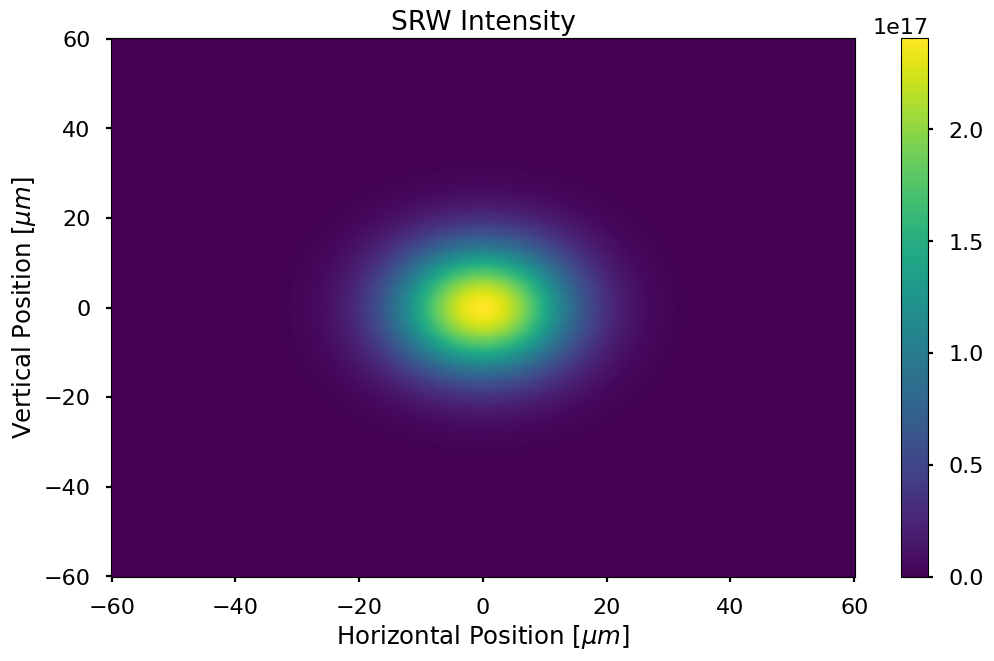

In [5]:
# plot the computed intensity
if RENDER_2D_PLOTS:
    with plt.style.context(('seaborn-poster')):
        fig = plt.figure(figsize=(12,7))
        ax = fig.gca()

        # By setting wfr0a.unitElFldAng=1, default units should  now be in mrad(?)
        plt.pcolormesh(np.multiply(x0,1e6), np.multiply(y0,1e6), intens_2d_0, cmap=plt.cm.viridis,shading='auto')
        plt.colorbar()
        ax.set_ylabel(r'Vertical Position [$\mu m$]')
        ax.set_xlabel(r'Horizontal Position [$\mu m$]')
        ax.set_title('SRW Intensity')

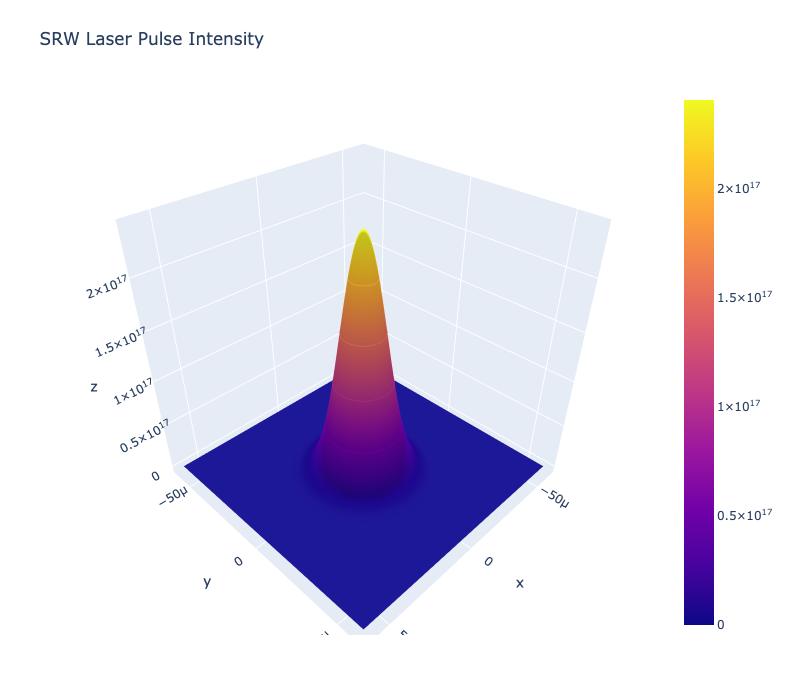

In [6]:
# plot the 3D intensity
if RENDER_3D_PLOTS:
    fig = go.Figure(data=[go.Surface(x=x0, y=y0, z=intens_2d_0)])
    fig.update_traces(contours_z=dict(show=True, usecolormap=True,
        highlightcolor="limegreen", project_z=True)
    )
    fig.update_layout(title='SRW Laser Pulse Intensity', autosize=False,
        width=800, height=700, margin=dict(l=65, r=50, b=65, t=90)
    )
    fig.show()

Third: obtain E [V/m] from SRW (need correct multiplicative factor)

In [7]:
# SRW intensity variable: intens_2d_0
# For vacuum: |E|^2 = sqrt(\mu0/\eps0)*I

mu0 = 1.25663706212e-6 # vacuum magnetic permeability [N*A^−2]
eps0 = 8.8541878128e-12 # permittivity of free space [F*m^−1]

E_abs_sqrd_2d = np.sqrt(mu0 / eps0) * intens_2d_0 # [V^2/m^2]
E_mag_2d = np.sqrt(E_abs_sqrd_2d) # [V/m]


Plot E magnitude [V/m]

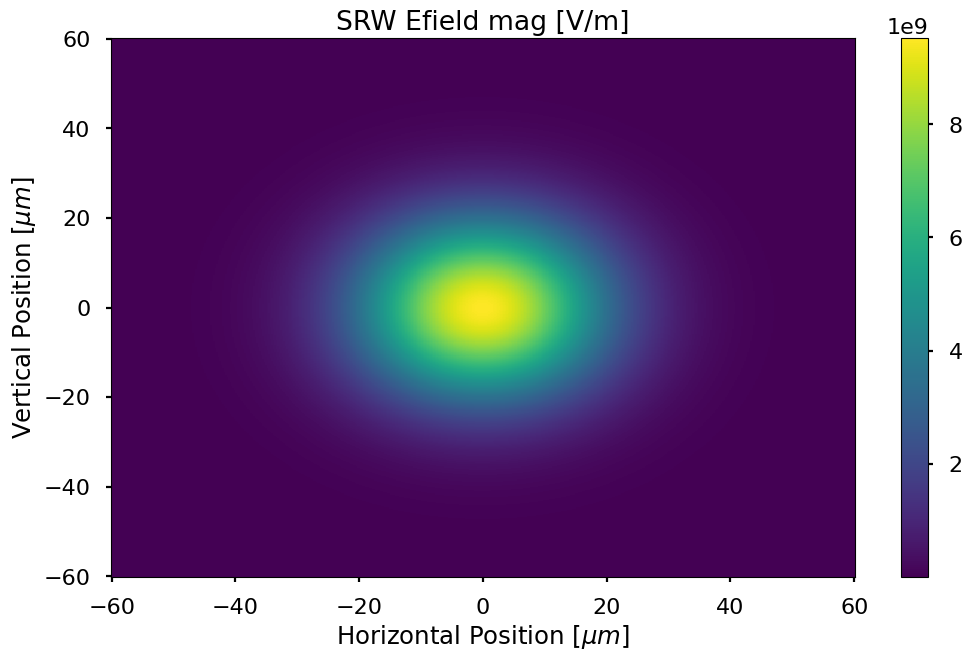

In [8]:
# plot the computed intensity
if RENDER_2D_PLOTS:
    with plt.style.context(('seaborn-poster')):
        fig = plt.figure(figsize=(12,7))
        ax = fig.gca()

        # By setting wfr0a.unitElFldAng=1, default units should  now be in mrad(?)
        plt.pcolormesh(np.multiply(x0,1e6), np.multiply(y0,1e6), E_mag_2d, cmap=plt.cm.viridis,shading='auto')
        plt.colorbar()
        ax.set_ylabel(r'Vertical Position [$\mu m$]')
        ax.set_xlabel(r'Horizontal Position [$\mu m$]')
        ax.set_title('SRW Efield mag [V/m]')

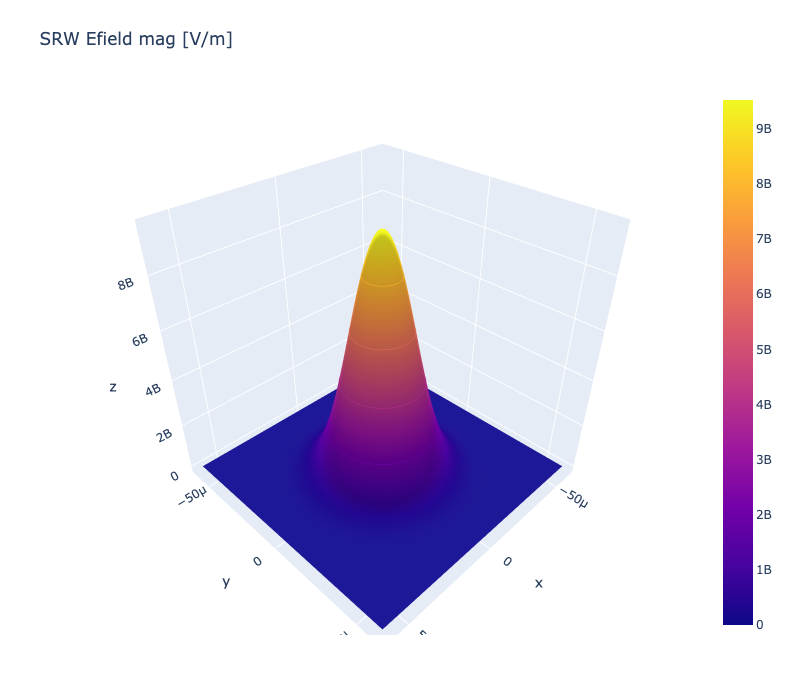

In [9]:
# plot the 3D intensity
if RENDER_3D_PLOTS:
    fig = go.Figure(data=[go.Surface(x=x0, y=y0, z=E_mag_2d)])
    fig.update_traces(contours_z=dict(show=True, usecolormap=True,
        highlightcolor="limegreen", project_z=True)
    )
    fig.update_layout(title='SRW Efield mag [V/m]', autosize=False,
        width=800, height=700, margin=dict(l=65, r=50, b=65, t=90)
    )
    fig.show()

Fourth: from the SRW wavefront, using wavelength & slice width (in [s] or [m]), calculate the number of photons in each grid cell